In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
plt.style.use('ggplot')
plt.figure(figsize=(5,5))
import warnings
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split

<Figure size 500x500 with 0 Axes>

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb

In [ ]:
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay
from sklearn.metrics import classification_report
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score

In [ ]:
df=pd.read_csv("Breast_data.csv")
check=df.copy()
df.shape

(569, 32)

In [ ]:
df

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [ ]:
df.columns.tolist()

['id',
 'diagnosis',
 'radius_mean',
 'texture_mean',
 'perimeter_mean',
 'area_mean',
 'smoothness_mean',
 'compactness_mean',
 'concavity_mean',
 'concave points_mean',
 'symmetry_mean',
 'fractal_dimension_mean',
 'radius_se',
 'texture_se',
 'perimeter_se',
 'area_se',
 'smoothness_se',
 'compactness_se',
 'concavity_se',
 'concave points_se',
 'symmetry_se',
 'fractal_dimension_se',
 'radius_worst',
 'texture_worst',
 'perimeter_worst',
 'area_worst',
 'smoothness_worst',
 'compactness_worst',
 'concavity_worst',
 'concave points_worst',
 'symmetry_worst',
 'fractal_dimension_worst']

In [ ]:
df.drop(['id'], axis = 1, inplace = True)
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [ ]:
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [ ]:
df.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    object 
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                  5

In [ ]:
df['diagnosis'].value_counts()

diagnosis
B    357
M    212
Name: count, dtype: int64

In [ ]:
df['diagnosis'] = df['diagnosis'].map({'M': 0, 'B': 1})
df['diagnosis'].head(5)

0    0
1    0
2    0
3    0
4    0
Name: diagnosis, dtype: int64

In [ ]:
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,0,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,0,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,0,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,0,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [ ]:
# 1
concavity_mean = 1
for i in df['concavity_mean']:
  if i == 0:
    concavity_mean += 1
print(concavity_mean)

# 2
concave_points_mean = 1
for i in df['concave points_mean']:
  if i == 0:
    concave_points_mean += 1
print(concave_points_mean)

# 2
symmetry_mean = 1
for i in df['symmetry_mean']:
  if i == 0:
    symmetry_mean += 1
print(symmetry_mean)

14
14
1


HISTOGRAMS

In [ ]:
x1.hist(figsize=(25,20))
plt.show()

NameError: name 'x1' is not defined

PAIR PLOTS REPRESENTING THE RELATIONSHIP FROM ONE CLASS TO OTHER CLASS


In [ ]:
sns.pairplot(df, hue='diagnosis', diag_kind='kde', markers=["o", "s"])
plt.show()

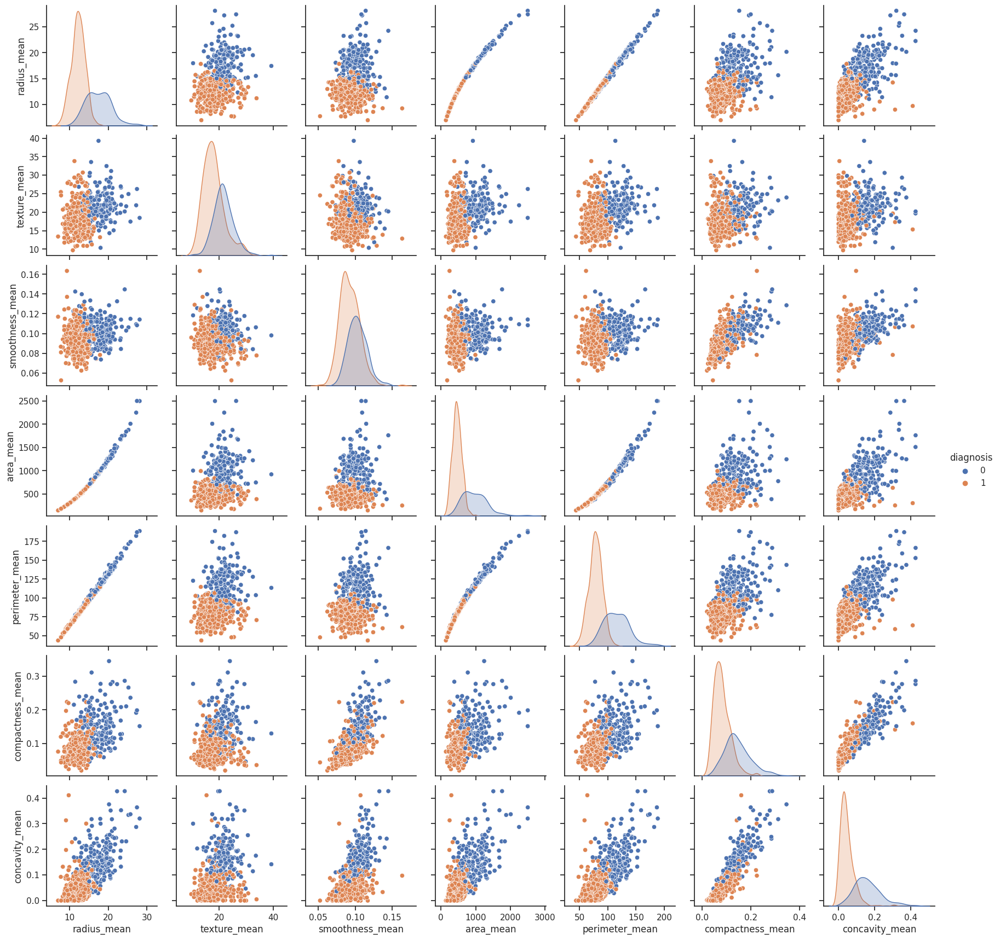

In [ ]:
selected_features = ['radius_mean', 'texture_mean', 'smoothness_mean', 'area_mean', 'perimeter_mean', 'compactness_mean', 'concavity_mean']
selected_features.append('diagnosis')
sns.set(style="ticks")
sns.pairplot(df[selected_features], hue='diagnosis')
plt.show()

PAIR PLOTS FOR MEAN COMPACTNESS vs MEAN CONCAVITY:

Pair plots that compare mean compactness with mean concavity, or similarly, compactness with concavity for worst values. These features are related to the shape and smoothness of the cell nuclei.

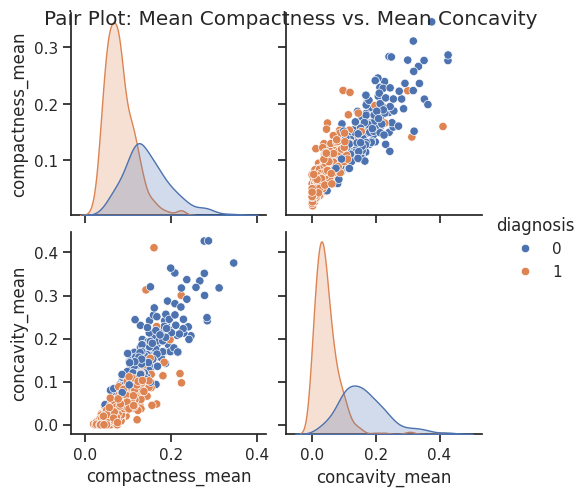

<Figure size 600x600 with 0 Axes>

In [ ]:
sns.set(style="ticks")
sns.pairplot(df, hue='diagnosis', vars=['compactness_mean', 'concavity_mean'])
plt.suptitle('Pair Plot: Mean Compactness vs. Mean Concavity')
plt.figure(figsize=(6,6))
plt.show()

PIE CHART THAT REPRESENTS THE DISTRIBUTION OF DIAGNOSIS(M or B)

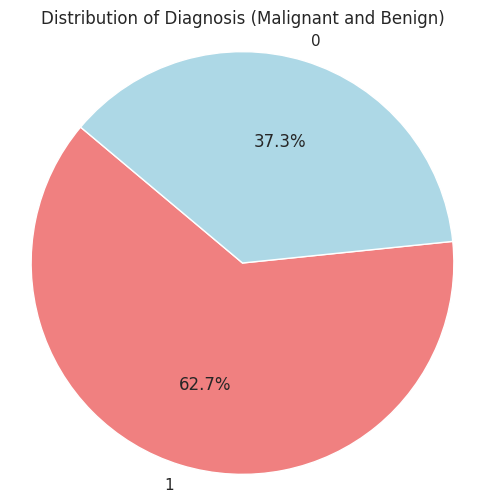

In [ ]:
class_counts = df['diagnosis'].value_counts()
labels = class_counts.index
sizes = class_counts.values

plt.figure(figsize=(6, 6))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140, colors=['lightcoral', 'lightblue'])
plt.title('Distribution of Diagnosis (Malignant and Benign)')
plt.axis('equal')
plt.show()

SCATTERPLOT FOR MEAN RADIUS vs MEAN TEXTURE:

mean_radius--> represents the mean of distances from the center to points on the perimeter of the tumor.

mean_texture--> represents the standard deviation of gray-scale values for the cell nuclei.

SCATTERPLOT FOR MEAN PERIMETER vs MEAN AREA:

mean_perimeter--> Represents the mean size of the tumor's perimeter.

mean_area--> Represents the mean size of the tumor's area.

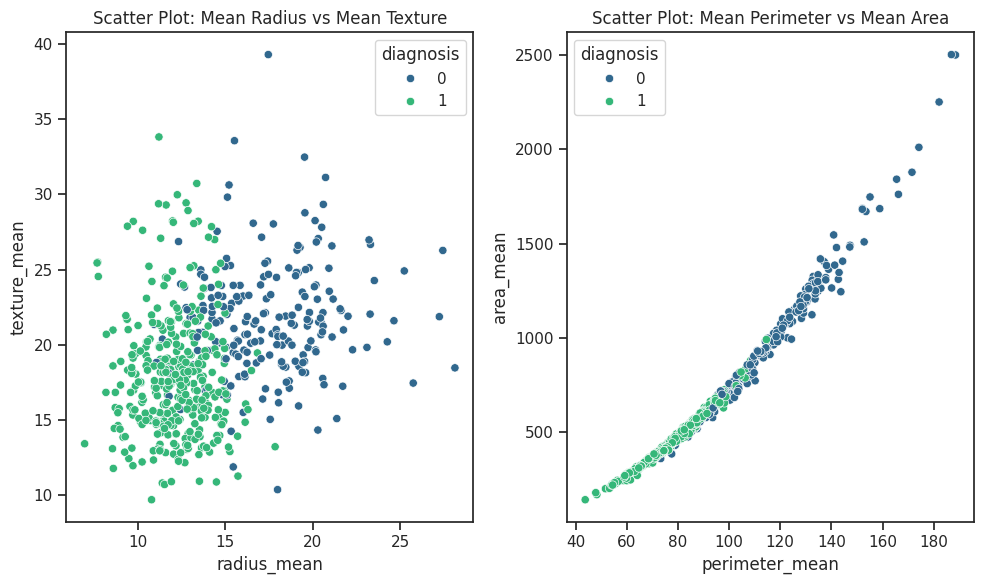

In [ ]:
plt.figure(figsize=(10, 6))
plt.subplot(1, 2, 1)
sns.scatterplot(data=df, x='radius_mean', y='texture_mean', hue='diagnosis', palette='viridis')
plt.title('Scatter Plot: Mean Radius vs Mean Texture')

plt.subplot(1, 2, 2)
sns.scatterplot(data=df, x='perimeter_mean', y='area_mean', hue='diagnosis', palette='viridis')
plt.title('Scatter Plot: Mean Perimeter vs Mean Area')

plt.tight_layout()
plt.show()

SCATTERPLOT FOR MEAN COMPACTNESS vs MEAN CONCAVITY:

mean_compactness--> Represents the mean of the compactness of the cell nuclei.

mean_concavity--> Represents the mean of severity of concave portions of the contour.



SCATTERPLOT FOR MEAN SMOOTHNESS vs MEAN SYMMETRY:

mean_smoothness--> Represents the mean of smoothness of the tumor.

mean_symmetry--> Represents the mean symmetry of the tumor

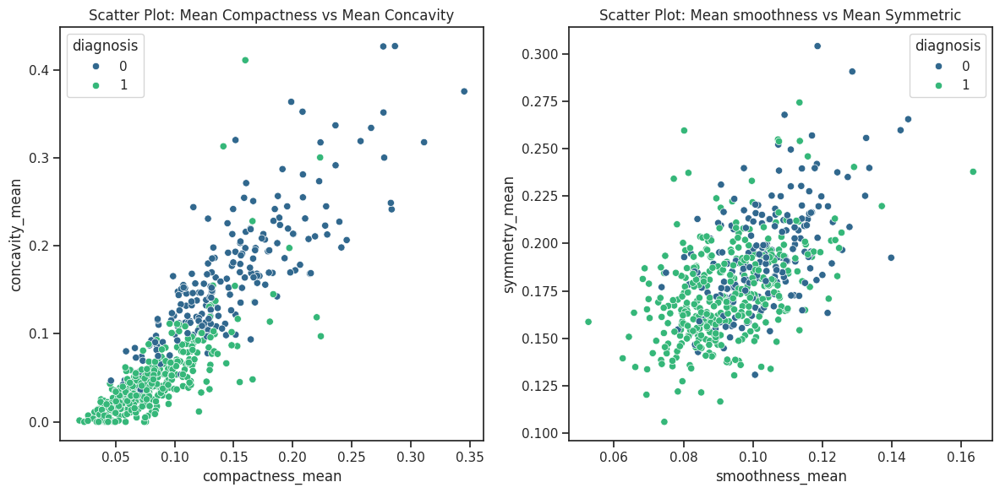

In [ ]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.scatterplot(data=df, x='compactness_mean', y='concavity_mean', hue='diagnosis', palette='viridis')
plt.title('Scatter Plot: Mean Compactness vs Mean Concavity')

plt.subplot(1, 2, 2)
sns.scatterplot(data=df, x='smoothness_mean', y='symmetry_mean', hue='diagnosis', palette='viridis')
plt.title('Scatter Plot: Mean smoothness vs Mean Symmetric')

plt.tight_layout()
plt.show()

SCATTERPLOT FOR MEAN COMPACTNESS vs MEAN FRACTAL DIMENSION:

mean_compactness--> Represents the mean of the compactness of the cell nuclei.

mean_fractal_dimension--> Represents the mean of "coastline approximation".

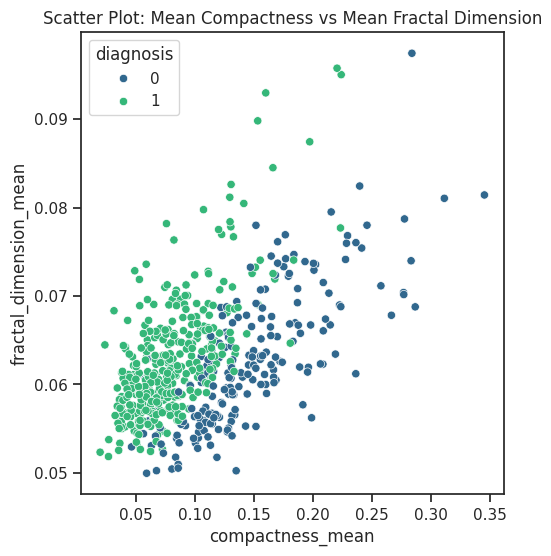

In [ ]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.scatterplot(data=df, x='compactness_mean', y='fractal_dimension_mean', hue='diagnosis', palette='viridis')
plt.title('Scatter Plot: Mean Compactness vs Mean Fractal Dimension')
plt.show()

In [ ]:
x=df.drop(["diagnosis"],axis=1)
y=df["diagnosis"]

In [ ]:
X_train, X_test,Y_train,Y_test=train_test_split(x,y,test_size=0.2,random_state=0)

In [ ]:
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,0,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,0,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,0,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,0,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [ ]:
dt=DecisionTreeClassifier()

In [ ]:
dt.fit(X_train,Y_train)

DecisionTreeClassifier()

TRAINING SET ACCURACY

In [ ]:
Y_train_pred = dt.predict(X_train)
dtacc = accuracy_score(Y_train,Y_train_pred)
print('Accuracy score:'+str(dtacc))


Accuracy score:1.0


ValueError: The number of FixedLocator locations (30), usually from a call to set_ticks, does not match the number of labels (5).

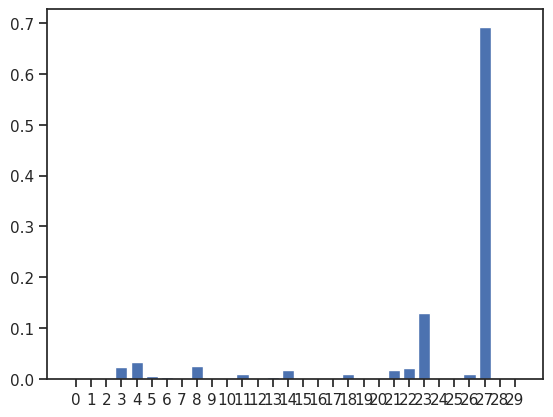

In [ ]:
importances = dt.feature_importances_
fig, ax = plt.subplots()
ax.bar(range(len(importances)), importances)
ax.set_xticks(range(len(importances)))
ax.set_xticklabels(x1.columns,rotation=90)
ax.set_title('Feature Importances')
ax.set_xlabel('Feature')
ax.set_ylabel('Importance')
plt.show()

TESTING SET ACCURACY

In [ ]:
decison_pred = dt.predict(X_test)
dt_acc = accuracy_score(Y_test, decison_pred)
print('Accuracy Score: ' + str(dt_acc))
print('Classification Report: \n' + str(classification_report(Y_test, decison_pred)))

Accuracy Score: 0.9035087719298246
Classification Report: 
              precision    recall  f1-score   support

           0       0.86      0.91      0.89        47
           1       0.94      0.90      0.92        67

    accuracy                           0.90       114
   macro avg       0.90      0.91      0.90       114
weighted avg       0.91      0.90      0.90       114



In [ ]:
cm = confusion_matrix(Y_test, decison_pred)

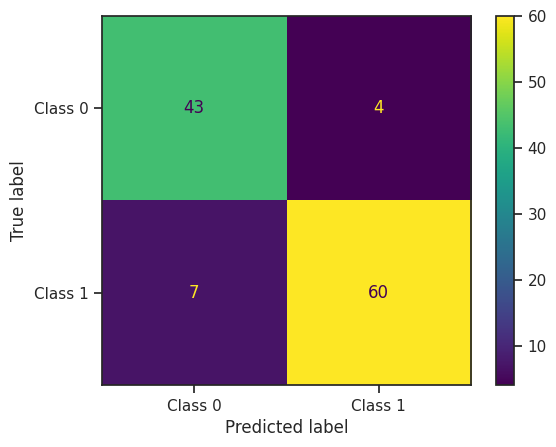

In [ ]:
class_labels = ['Class 0', 'Class 1']
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot()
plt.show()

In [ ]:
lr=LogisticRegression()

In [ ]:
lr.fit(X_train,Y_train)

LogisticRegression()

TRAINING SET ACCURACY

In [ ]:
Y_train_pred = lr.predict(X_train)
training_accuracy = accuracy_score(Y_train,Y_train_pred)
print('Accuracy score:'+str(training_accuracy))

Accuracy score:0.9538461538461539


TESTING SET ACCURACY

In [ ]:
pred_logits = lr.predict(X_test)
logits_acc = accuracy_score(Y_test, pred_logits)
print('Accuracy Score: ' + str(logits_acc))
print('Classification Report: \n' + str(classification_report(Y_test, pred_logits)))

Accuracy Score: 0.9473684210526315
Classification Report: 
              precision    recall  f1-score   support

           0       0.92      0.96      0.94        47
           1       0.97      0.94      0.95        67

    accuracy                           0.95       114
   macro avg       0.94      0.95      0.95       114
weighted avg       0.95      0.95      0.95       114



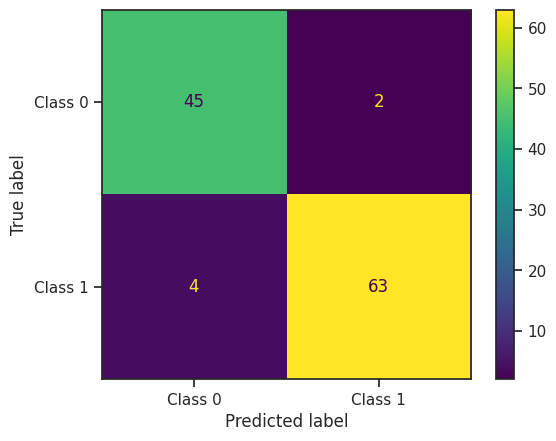

In [ ]:
cm = confusion_matrix(Y_test, pred_logits)
class_labels = ['Class 0', 'Class 1']
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot()
plt.show()

In [ ]:
knn=KNeighborsClassifier()

In [ ]:
knn.fit(X_train,Y_train)

KNeighborsClassifier()

TRAINING SET ACCURACY

In [ ]:
Y_train_pred = knn.predict(X_train)
training_accuracy = accuracy_score(Y_train,Y_train_pred)
print('Accuracy score:'+str(training_accuracy))


Accuracy score:0.9494505494505494


TESTING SET ACCURACY

In [ ]:
knn_pred = knn.predict(X_test)
knn_acc = accuracy_score(Y_test, knn_pred)
print('Accuracy Score: ' + str(knn_acc))
print('Classification Report: \n' + str(classification_report(Y_test, knn_pred)))

Accuracy Score: 0.9385964912280702
Classification Report: 
              precision    recall  f1-score   support

           0       0.92      0.94      0.93        47
           1       0.95      0.94      0.95        67

    accuracy                           0.94       114
   macro avg       0.94      0.94      0.94       114
weighted avg       0.94      0.94      0.94       114



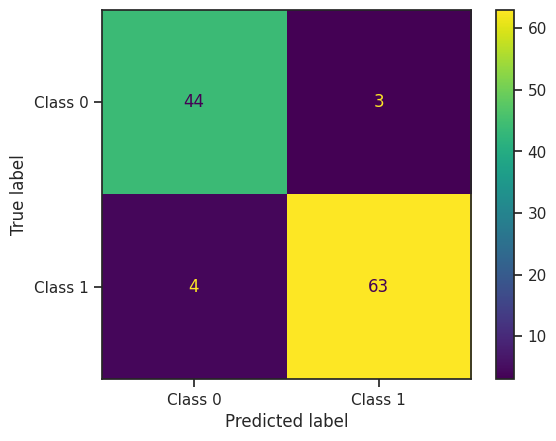

In [ ]:
cm = confusion_matrix(Y_test, knn_pred)
class_labels = ['Class 0', 'Class 1']
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot()
plt.show()

In [ ]:
rf=RandomForestClassifier()

In [ ]:
rf.fit(X_train,Y_train)

RandomForestClassifier()

TRAINING SET ACCURACY

In [ ]:
Y_train_pred = rf.predict(X_train)
training_accuracy = accuracy_score(Y_train,Y_train_pred)
print('Accuracy score:'+str(training_accuracy))


Accuracy score:1.0


ValueError: The number of FixedLocator locations (30), usually from a call to set_ticks, does not match the number of labels (5).

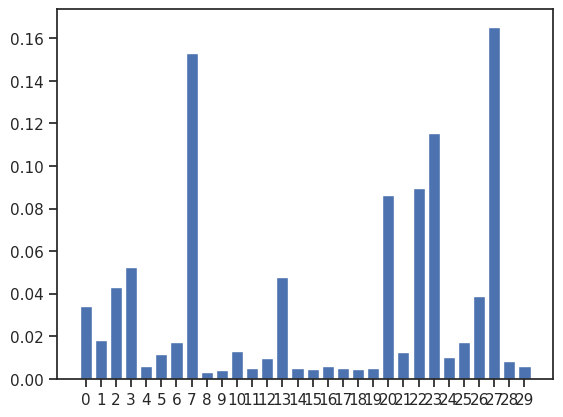

In [ ]:
importances = rf.feature_importances_
fig, ax = plt.subplots()
ax.bar(range(len(importances)), importances)
ax.set_xticks(range(len(importances)))
ax.set_xticklabels(x1.columns,rotation=90)
ax.set_title('Feature Importances')
ax.set_xlabel('Feature')
ax.set_ylabel('Importance')
plt.show()

TESTING SET ACCURACY

In [ ]:
random_pred = rf.predict(X_test)
rf_acc = accuracy_score(Y_test, random_pred)
print('Accuracy Score: ' + str(rf_acc))
print('Classification Report: \n' + str(classification_report(Y_test, random_pred)))

Accuracy Score: 0.9649122807017544
Classification Report: 
              precision    recall  f1-score   support

           0       0.94      0.98      0.96        47
           1       0.98      0.96      0.97        67

    accuracy                           0.96       114
   macro avg       0.96      0.97      0.96       114
weighted avg       0.97      0.96      0.97       114



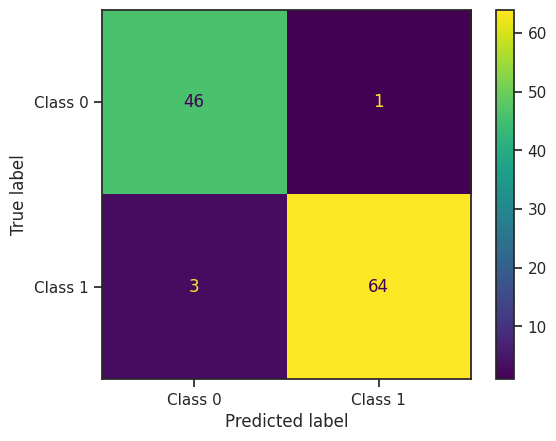

In [ ]:
cm = confusion_matrix(Y_test, random_pred)
class_labels = ['Class 0', 'Class 1']
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot()
plt.show()

XGBOOST CLASSIFIER

In [ ]:
from xgboost import XGBClassifier

In [ ]:
func=XGBClassifier()
func.fit(X_train,Y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

TRAINING SET ACCURACY

In [ ]:
Y_train_pred = func.predict(X_train)
training_accuracy = accuracy_score(Y_train,Y_train_pred)
print('Accuracy score:'+str(training_accuracy))


Accuracy score:1.0


ValueError: The number of FixedLocator locations (30), usually from a call to set_ticks, does not match the number of labels (5).

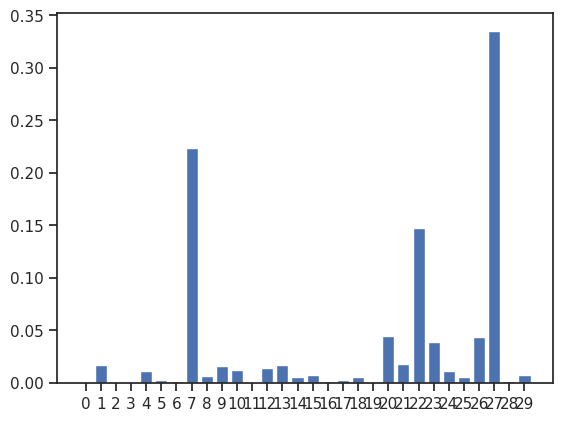

In [ ]:
importances = func.feature_importances_
fig, ax = plt.subplots()
ax.bar(range(len(importances)), importances)
ax.set_xticks(range(len(importances)))
ax.set_xticklabels(x1.columns,rotation=90)
ax.set_title('Feature Importances')
ax.set_xlabel('Feature')
ax.set_ylabel('Importance')
plt.show()

TESTING SET ACCURACY

In [ ]:
func=XGBClassifier()
func.fit(X_train,Y_train)
pred=func.predict(X_test)
XGB_acc=(accuracy_score(Y_test,pred))
print('Accuracy Score: ' + str(XGB_acc))
print('Classification Report: \n' + str(classification_report(Y_test, pred)))

Accuracy Score: 0.956140350877193
Classification Report: 
              precision    recall  f1-score   support

           0       0.94      0.96      0.95        47
           1       0.97      0.96      0.96        67

    accuracy                           0.96       114
   macro avg       0.95      0.96      0.95       114
weighted avg       0.96      0.96      0.96       114



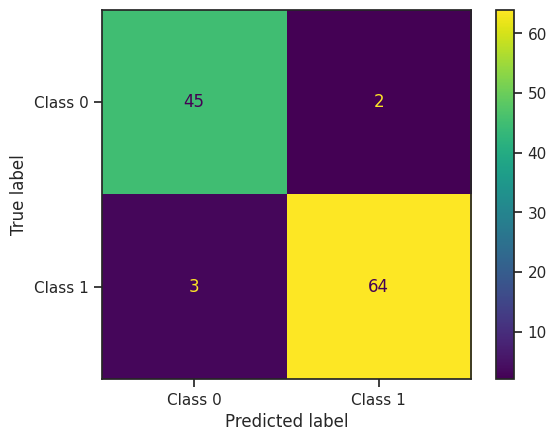

In [ ]:
cm = confusion_matrix(Y_test, pred)
class_labels = ['Class 0', 'Class 1']
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot()
plt.show()

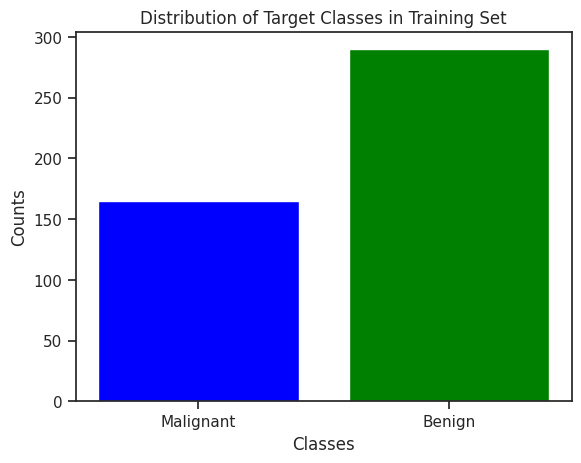

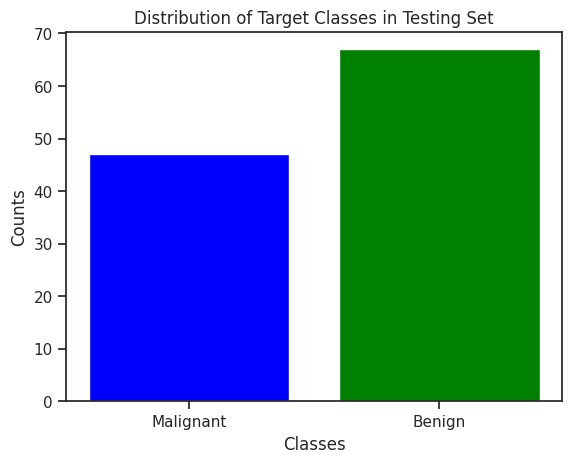

In [ ]:
def plot_training_data_distribution(Y_train):
    labels = ['Malignant', 'Benign']
    train_counts = np.bincount(Y_train)
    x = np.arange(len(labels))
    fig, ax = plt.subplots()
    colors = ['blue', 'green']
    ax.bar(x, train_counts, color=colors)
    ax.set_xlabel('Classes')
    ax.set_ylabel('Counts')
    ax.set_title('Distribution of Target Classes in Training Set')
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.show()

def plot_testing_data_distribution(Y_test):
    labels = ['Malignant', 'Benign']
    test_counts = np.bincount(Y_test)
    x = np.arange(len(labels))
    fig, ax = plt.subplots()
    colors = ['blue', 'green']
    ax.bar(x, test_counts, color=colors)
    ax.set_xlabel('Classes')
    ax.set_ylabel('Counts')
    ax.set_title('Distribution of Target Classes in Testing Set')
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    plt.show()
plot_training_data_distribution(Y_train)
plot_testing_data_distribution(Y_test)


In [ ]:
print('\n                             Accuracy')
print('                            -------------')

print('Logistic Regression        : {:.04} %'.format(logits_acc * 100))
print('KNN Classifier             : {:.04} %'.format(knn_acc * 100))
print('Decision Trees Classifier  : {:.04} %'.format(dt_acc * 100))
print('Random Forest Classifier   : {:.04} %'.format(rf_acc * 100))
print('XGB Classifier             : {:.04} %'.format(XGB_acc * 100))



                             Accuracy
                            -------------
Logistic Regression        : 94.74 %
KNN Classifier             : 93.86 %
Decision Trees Classifier  : 90.35 %
Random Forest Classifier   : 96.49 %
XGB Classifier             : 95.61 %


Text(0.5, 1.0, 'Accuracy Comparision')

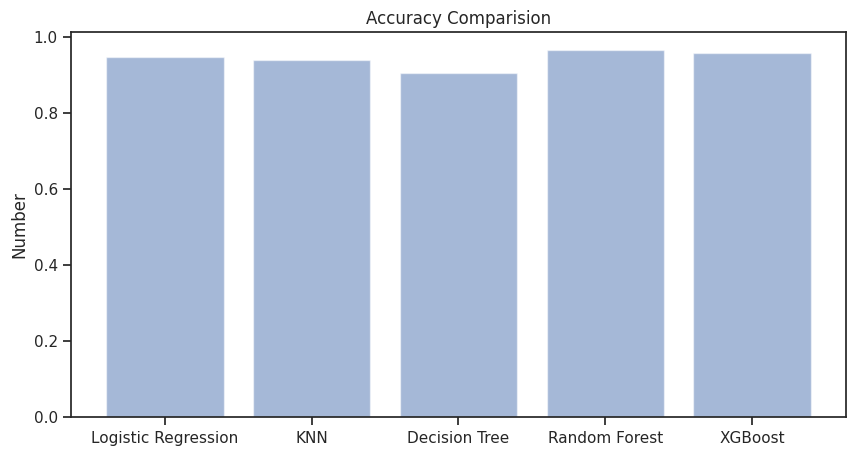

In [ ]:
figure = plt.figure(figsize=(10, 5))
objects = ['Logistic Regression',
           'KNN',
           'Decision Tree',
           'Random Forest',
           'XGBoost']
y_pos = np.arange(len(objects))
plt.bar(y_pos,[logits_acc,knn_acc,dt_acc,rf_acc,XGB_acc],alpha=0.5)
plt.xticks(y_pos,objects)
plt.ylabel('Number')
plt.title('Accuracy Comparision')